In [26]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
color = sns.color_palette()

import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.tools as tls
import plotly.express as px

from wordcloud import WordCloud, STOPWORDS
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score, confusion_matrix

import string
import re

from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_extraction.text import CountVectorizer
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer

from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import MultinomialNB

from tensorflow.keras.utils import to_categorical
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from keras.layers import Dense , LSTM , Embedding
from keras.models import Sequential
from keras.callbacks import EarlyStopping

import warnings
warnings.filterwarnings('ignore')

import pickle

import nltk
from nltk.corpus import stopwords

In [27]:
import pandas as pd
df = pd.read_csv(r"C:\Users\SOUMYA\@AI\NLP\Reviews.csv")
df.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,Great taffy,Great taffy at a great price. There was a wid...


In [28]:
# Product Scores
fig = px.histogram(df, x="Score")
fig.update_traces(marker_color="turquoise",marker_line_color='rgb(8,48,107)',
                  marker_line_width=1.5)
fig.update_layout(title_text='Product Score')
fig.show()

In [29]:
# Check null values
df.isna().sum().to_frame(name='# of missing values')

,# of missing values
Id,0
ProductId,0
UserId,0
ProfileName,16
HelpfulnessNumerator,0
HelpfulnessDenominator,0
Score,0
Time,0
Summary,27
Text,0


In [30]:
total_rows =  df.shape[0]
df.dropna(how='any',inplace=True)
remaining_rows= df.shape[0]

removed_rows = total_rows-remaining_rows
print("No. of rows removed :", removed_rows)

print(f"\nPercentage of data removed:{np.round((removed_rows/total_rows)*100,2)}%")
print(f"Percentage of data remaining:{np.round((remaining_rows/total_rows)*100,2)}%")

No. of rows removed : 43

Percentage of data removed:0.01%
Percentage of data remaining:99.99%


In [ ]:
a =  data.shape[0]
data.drop_duplicates(inplace=True, subset=['Score','Text'])
b = data.shape[0]

print("No. of rows removed :", a-b)

print(f"\nPercentage of data removed: {np.round(((a-b)/total_rows)*100,2)}%")
print(f"Percentage of data remaining: {np.round((b/total_rows)*100,2)}%")

In [33]:
a =  df.shape[0]
idx = df[df["HelpfulnessNumerator"]>df["HelpfulnessDenominator"]].index
df.drop(index=idx, inplace=True)
b = df.shape[0]

print("No. of rows removed :", a-b)

print(f"\nPercentage of data removed:{np.round(((a-b)/total_rows)*100,2)}%")
print(f"Percentage of data remaining:{np.round((b/total_rows)*100,2)}%")

No. of rows removed : 0

Percentage of data removed:0.0%
Percentage of data remaining:99.99%


In [34]:
# assign reviews with score > 3 as positive sentiment
# score < 3 negative sentiment
# remove score = 3
df = df[df['Score'] != 3]
df['sentiment'] = df['Score'].apply(lambda rating : +1 if rating > 3 else -1)

In [35]:
# target column 
df[['Score', 'sentiment']].sample(5)

,Score,sentiment
420648,5,1
111840,5,1
514455,5,1
256941,5,1
47376,1,-1


In [6]:
# split df - positive and negative sentiment:
positive = df[df['sentiment'] == 1]
negative = df[df['sentiment'] == -1]

In [11]:
df['sentimentt'] = df['sentiment'].replace({-1 : 'negative'})
df['sentimentt'] = df['sentimentt'].replace({1 : 'positive'})
fig = px.histogram(df, x="sentimentt")
fig.update_traces(marker_color="indianred",marker_line_color='rgb(8,48,107)',
                  marker_line_width=1.5)
fig.update_layout(title_text='Product Sentiment')
fig.show()

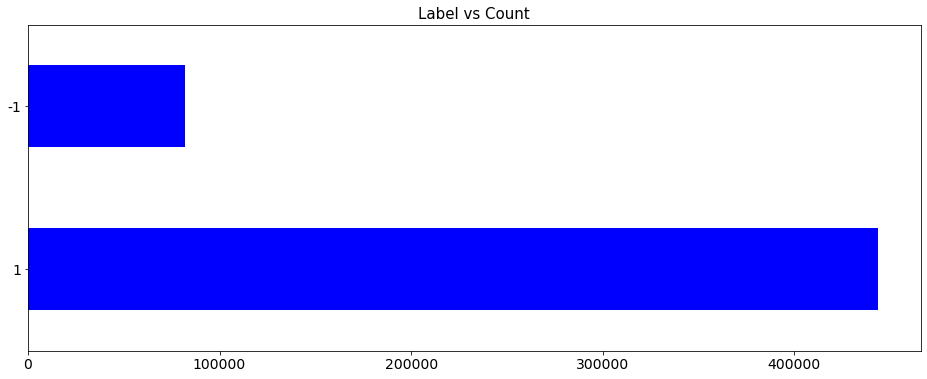

In [37]:
fig, ax = plt.subplots(figsize=(16, 6))

vc = df.sentiment.value_counts()
vc.plot.barh(color="blue",fontsize=14,ax=ax)
ax.set_title("Label vs Count", fontsize=15)
plt.show()

down sapmling

In [ ]:
#neutral = df.loc[data.sentiment=="Neutral"] # 29770 reviews
positive = df.loc[data.sentiment== 1].sample(50000)
negative = df.loc[data.sentiment== -1].sample(50000)

df = pd.concat([positive, negative])
df.shape

In [ ]:
fig, ax = plt.subplots(figsize=(16, 6))

vc = data.sentiment.value_counts()
vc.plot.barh(color="blue",fontsize=14,ax=ax)
ax.set_title("Label vs Count", fontsize=15)
plt.show()

In [38]:
# stopwords
total_stopwords = set(stopwords.words('english'))

# subtract negative stop words like no, not, don't etc.. from total_stopwords
negative_stop_words = set(word for word in total_stopwords 
                          if "n't" in word or 'no' in word)

final_stopwords = total_stopwords - negative_stop_words

# 
final_stopwords.add("one")
print(final_stopwords)

{'him', 'hers', 'where', "should've", 'who', 'is', 'his', 'have', 'she', 'won', 'above', 'couldn', "that'll", 'their', 'a', 'it', 'my', 'shouldn', 'can', 'any', 'for', 'theirs', 'myself', 'why', 'those', 'don', 'out', 'too', 'than', 'has', 'doing', 'its', 'against', 're', 'be', 'so', 'we', 'each', 'by', 'will', 'about', 'own', 'while', 'other', 'few', 'were', 'doesn', 'which', 'had', 'needn', 'once', 'most', 'shan', 'do', 'both', 'y', 'after', 'they', 'been', 'should', 'her', 'o', 'aren', 'ourselves', 'through', 'themselves', 'herself', 'more', 'when', 'to', 'same', 'of', 's', 'an', 'hadn', 'm', "you're", 'some', 'from', 'as', 'such', 'this', 'itself', 'then', 'weren', 'having', 'mightn', 'that', 'me', 'just', 'did', 'these', "you'll", 'he', 'up', 'at', 'what', 'll', 'yourselves', 'd', 'only', 'being', 'and', 'haven', 'the', 'below', 've', 'you', 'before', 'wouldn', 'himself', 'again', 'here', 'all', 'hasn', 'mustn', 'does', 'during', 'further', 'there', 'our', 'on', 'off', 'yourself',

In [39]:
#Stemming is a technique used to extract the base form of the words by removing affixes from them.
#It is just like cutting down the branches of a tree to its stems.
#For example, the stem of the words eating, eats, eaten is eat.

#stemming object
stemmer = PorterStemmer()

# ---------------------------------------------
HTMLTAGS = re.compile('<.*?>')
table = str.maketrans(dict.fromkeys(string.punctuation))
remove_digits = str.maketrans('', '', string.digits)
MULTIPLE_WHITESPACE = re.compile(r"\s+")
# ---------------------------------------------

In [40]:
def preprocessor(review):
    # remove html tags
    review = HTMLTAGS.sub(r'', review)

    # remove puncutuation
    review = review.translate(table)
    
    # remove digits
    review = review.translate(remove_digits)
    
    # lower case all letters
    review = review.lower()
    
    # replace multiple white spaces with single space
    review = MULTIPLE_WHITESPACE.sub(" ", review).strip()
    
    # remove stop words
    review = [word for word in review.split()
              if word not in final_stopwords]
    
    # stemming
    review = ' '.join([stemmer.stem(word) for word in review])
    
    return review

In [41]:
print("Before preprocessing : ")
df.Text.iloc[6]

Before preprocessing : 


"This saltwater taffy had great flavors and was very soft and chewy.  Each candy was individually wrapped well.  None of the candies were stuck together, which did happen in the expensive version, Fralinger's.  Would highly recommend this candy!  I served it at a beach-themed party and everyone loved it!"

In [43]:
# apply preprocessing function

df.Text = df.Text.apply(preprocessor) 
print("After preprocessing : ")
df.Text.iloc[6]

After preprocessing : 


'saltwat taffi great flavor soft chewi candi individu wrap well none candi stuck togeth happen expens version fraling would highli recommend candi serv beachthem parti everyon love'

In [44]:
def generate_wcloud(text):
    stopwords = set(STOPWORDS)
    
    wordcloud = WordCloud(stopwords=stopwords, background_color='white')
    wordcloud.generate(text)
    
    plt.figure(figsize=(15,7))
    plt.axis('off')
    plt.imshow(wordcloud, interpolation='bilinear')
    return plt.show()



# Create stopword list:
#stopwords = set(stopwords.words('english'))
#stopwords.update(["br", "href"])
#textt = " ".join(review for review in df.Text)
#from wordcloud import WordCloud 
#wordcloud = WordCloud(stopwords=stopwords).generate(textt)
#plt.imshow(wordcloud, interpolation='bilinear')
#plt.axis("off")
#plt.savefig('wordcloud11.png')
#plt.show()

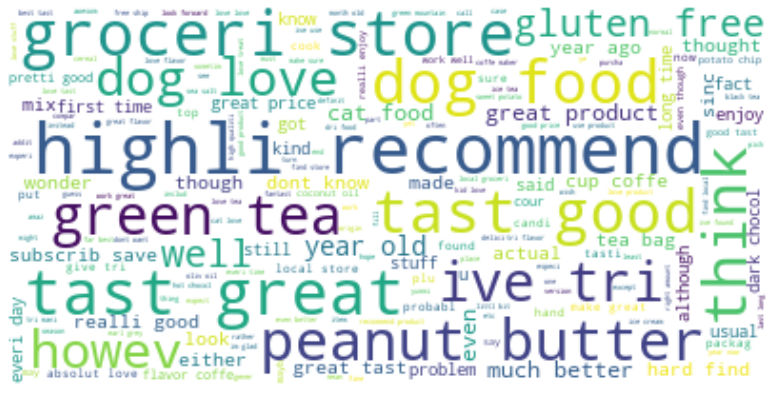

In [46]:
pos = df.loc[df.sentiment== 1].Text
text = " ".join(review for review in pos.astype(str))

generate_wcloud(text)

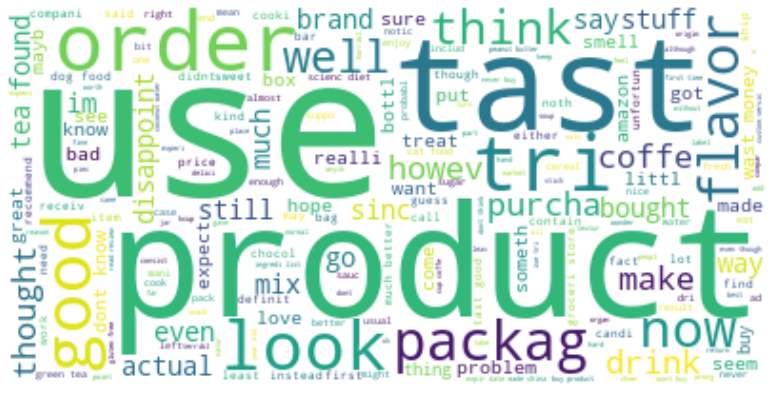

In [49]:
neg = df.loc[df.sentiment== -1].Text
text = " ".join(review for review in neg.astype(str))

generate_wcloud(text)

In [50]:
X = df.Text
y = df.sentiment

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=1, stratify=y)

Bag of Words Vectorizer

In [51]:
bow_vectorizer = CountVectorizer(max_features=10000)
bow_vectorizer.fit(X_train)

# transform
bow_X_train = bow_vectorizer.transform(X_train)
bow_X_test = bow_vectorizer.transform(X_test)

TF-IDF Vectorizer

In [52]:
tfidf_vectorizer = TfidfVectorizer(max_features=10000)
tfidf_vectorizer.fit(X_train)

# transform
tfidf_X_train = tfidf_vectorizer.transform(X_train)
tfidf_X_test = tfidf_vectorizer.transform(X_test)

In [53]:
labelEncoder = LabelEncoder()

y_train = labelEncoder.fit_transform(y_train)
y_test = labelEncoder.transform(y_test)

labels = labelEncoder.classes_.tolist()
print(labels) # index-> class

[-1, 1]


In [54]:
def train_and_eval(model, trainX, trainY, testX, testY):

    # training
    _ = model.fit(trainX, trainY)

    # predictions
    y_preds_train = model.predict(trainX)
    y_preds_test = model.predict(testX)

    # evaluation
    print()
    print(model)
    print(f"Train accuracy score : {accuracy_score(y_train, y_preds_train)}")
    print(f"Test accuracy score : {accuracy_score(y_test, y_preds_test)}")
    print('\n',40*'-')

logistic regression with bow

In [55]:
# Hyperparameters
C = [0.001, 0.01, 0.1, 1, 10]

for c in C: 
    # Define model
    log_model = LogisticRegression(C=c, max_iter=500, random_state=1)
    
    # Train and evaluate model
    train_and_eval(model=log_model,
                   trainX=bow_X_train,
                   trainY=y_train,
                   testX=bow_X_test,
                   testY=y_test)


LogisticRegression(C=0.001, max_iter=500, random_state=1)
Train accuracy score : 0.9004864294273162
Test accuracy score : 0.899177404783415

 ----------------------------------------

LogisticRegression(C=0.01, max_iter=500, random_state=1)
Train accuracy score : 0.924263461209274
Test accuracy score : 0.920992820122676

 ----------------------------------------

LogisticRegression(C=0.1, max_iter=500, random_state=1)
Train accuracy score : 0.9355920839910987
Test accuracy score : 0.9295516142836765

 ----------------------------------------

LogisticRegression(C=1, max_iter=500, random_state=1)
Train accuracy score : 0.9406846149456987
Test accuracy score : 0.9311682754029765

 ----------------------------------------

LogisticRegression(C=10, max_iter=500, random_state=1)
Train accuracy score : 0.9419565589516329
Test accuracy score : 0.9306547477533166

 ----------------------------------------


naive bayes with bow

In [56]:
alphas = [0, 0.2, 0.6, 0.8, 1]

for a  in alphas: 
    # Define model
    nb_model = MultinomialNB(alpha=a)

    # Train and evaluate model
    train_and_eval(model=nb_model,
                   trainX=bow_X_train,
                   trainY=y_train,
                   testX=bow_X_test,
                   testY=y_test)


MultinomialNB(alpha=0)
Train accuracy score : 0.9071362002396485
Test accuracy score : 0.9039513099709952

 ----------------------------------------

MultinomialNB(alpha=0.2)
Train accuracy score : 0.9065774958632101
Test accuracy score : 0.9037135656887452

 ----------------------------------------

MultinomialNB(alpha=0.6)
Train accuracy score : 0.9062922000114119
Test accuracy score : 0.9034758214064952

 ----------------------------------------

MultinomialNB(alpha=0.8)
Train accuracy score : 0.9061138901040379
Test accuracy score : 0.9032951357519852

 ----------------------------------------

MultinomialNB(alpha=1)
Train accuracy score : 0.90604494360652
Test accuracy score : 0.9031144500974752

 ----------------------------------------


logistic regression with Tf-idf

In [57]:
# Hyperparameters
C = [0.001, 0.01, 0.1, 1, 10]

for c in C: 
    # Define model
    log_model = LogisticRegression(C=c, max_iter=500, random_state=1)
    
    # Train and evaluate model
    train_and_eval(model=log_model,
                   trainX=tfidf_X_train,
                   trainY=y_train,
                   testX=tfidf_X_test,
                   testY=y_test)


LogisticRegression(C=0.001, max_iter=500, random_state=1)
Train accuracy score : 0.8440263803564296
Test accuracy score : 0.8440207313014122

 ----------------------------------------

LogisticRegression(C=0.01, max_iter=500, random_state=1)
Train accuracy score : 0.8724180725412253
Test accuracy score : 0.8718082830107936

 ----------------------------------------

LogisticRegression(C=0.1, max_iter=500, random_state=1)
Train accuracy score : 0.9201718432013999
Test accuracy score : 0.9178450858256859

 ----------------------------------------

LogisticRegression(C=1, max_iter=500, random_state=1)
Train accuracy score : 0.9356277459725736
Test accuracy score : 0.9303409253007465

 ----------------------------------------

LogisticRegression(C=10, max_iter=500, random_state=1)
Train accuracy score : 0.9421586435133233
Test accuracy score : 0.9328895440064666

 ----------------------------------------


naive bayes with Tf-idf

In [58]:
alphas = [0, 0.2, 0.6, 0.8, 1]

for a  in alphas: 
    # Define model
    nb_model = MultinomialNB(alpha=a)

    # Train and evaluate model
    train_and_eval(model=nb_model,
                   trainX=tfidf_X_train,
                   trainY=y_train,
                   testX=tfidf_X_test,
                   testY=y_test)


MultinomialNB(alpha=0)
Train accuracy score : 0.8845241265192004
Test accuracy score : 0.8826208929675241

 ----------------------------------------

MultinomialNB(alpha=0.2)
Train accuracy score : 0.8840961827415029
Test accuracy score : 0.8822309923446341

 ----------------------------------------

MultinomialNB(alpha=0.6)
Train accuracy score : 0.8832498050478346
Test accuracy score : 0.881470210641434

 ----------------------------------------

MultinomialNB(alpha=0.8)
Train accuracy score : 0.8828789204404968
Test accuracy score : 0.8812419761304741

 ----------------------------------------

MultinomialNB(alpha=1)
Train accuracy score : 0.882118131502368
Test accuracy score : 0.8805953116827541

 ----------------------------------------


In [59]:
def plot_cm(y_true, y_pred):
    plt.figure(figsize=(6,6))
    
    cm = confusion_matrix(y_true, y_pred, normalize='true')
    
    sns.heatmap(
        cm, annot=True, cmap='Blues', cbar=False, fmt='.2f',
        xticklabels=labels, yticklabels=labels)
    
    return plt.show()

In [60]:
bmodel = LogisticRegression(C=1, max_iter=500, random_state=1)
bmodel.fit(tfidf_X_train, y_train)

LogisticRegression(C=1, max_iter=500, random_state=1)

In [61]:
# predictions
y_preds_train = bmodel.predict(tfidf_X_train)
y_preds_test = bmodel.predict(tfidf_X_test)

In [62]:
print(f"Train accuracy score : {accuracy_score(y_train, y_preds_train)}")
print(f"Test accuracy score : {accuracy_score(y_test, y_preds_test)}")

Train accuracy score : 0.9356277459725736
Test accuracy score : 0.9303409253007465


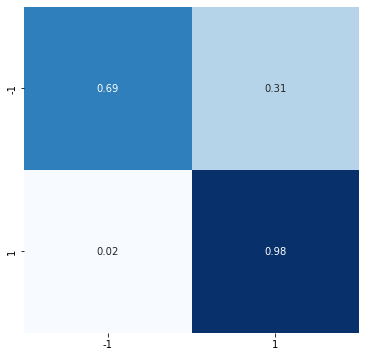

In [63]:
plot_cm(y_test, y_preds_test)

In [64]:
print(classification_report(y_test,y_preds_test))

              precision    recall  f1-score   support

           0       0.84      0.69      0.75     16402
           1       0.94      0.98      0.96     88753

    accuracy                           0.93    105155
   macro avg       0.89      0.83      0.86    105155
weighted avg       0.93      0.93      0.93    105155



In [65]:
with open("transformer.pkl", "wb") as f:
    pickle.dump(tfidf_vectorizer, f)
    
with open("model.pkl", "wb") as f:
    pickle.dump(bmodel, f)

In [66]:
# labels = ['Negative', 'Neutral', 'Positive']
def get_sentiment(review):
    # preprocessing
    x = preprocessor(review)
    #vectorization
    x = tfidf_vectorizer.transform([x])
    #prediction
    y = int(bmodel.predict(x.reshape(1,-1)))
    return labels[y]

In [69]:
# positve review
review = "This chips packet is very tasty. I highly recommend this!"
value = "negative"

if get_sentiment(review) == 1:
    value = "positive"

print(f"This is a {value} review!")

This is a positive review!


In [70]:
# positve review
review = "This product is a waste of money. Don't buy this!!"
value = "negative"

if get_sentiment(review) == 1:
    value = "positive"

print(f"This is a {value} review!")

This is a negative review!


In [ ]:
#https://www.naukri.com/learning/articles/spam-filtering-using-bag-of-words/
#https://medium.com/@cmukesh8688/tf-idf-vectorizer-scikit-learn-dbc0244a911a